In [1]:
'''
    University of West London
    Databases and analytics

    Victor Lima Gulart da Silva
    ID: 21409203
'''

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [10]:
# 1 - Import data
df = pd.read_csv('./telecom_dataset.csv')

In [14]:
# 2 - Inspecting data
print(df.isnull().sum())

state                        0
account length               0
area code                    0
phone number                 0
international plan           0
voice mail plan              0
number vmail messages        0
total day minutes            0
total day calls              0
Predicted total day calls    0
total day charge             0
total eve minutes            0
total eve calls              0
total eve charge             0
total night minutes          0
total night calls            0
total night charge           0
total intl minutes           0
total intl calls             0
total intl charge            0
customer service calls       0
churn                        0
dtype: int64


In [11]:
# 3 - Head of dataset
df.head()

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,Predicted total day calls,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,100,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,371-7191,no,yes,26,161.6,123,125,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,358-1921,no,no,0,243.4,114,113,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,375-9999,yes,no,0,299.4,71,70,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,330-6626,yes,no,0,166.7,113,111,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [12]:
# 5 - Column names
df.columns

Index(['state', 'account length', 'area code', 'phone number',
       'international plan', 'voice mail plan', 'number vmail messages',
       'total day minutes', 'total day calls', 'Predicted total day calls',
       'total day charge', 'total eve minutes', 'total eve calls',
       'total eve charge', 'total night minutes', 'total night calls',
       'total night charge', 'total intl minutes', 'total intl calls',
       'total intl charge', 'customer service calls', 'churn'],
      dtype='object')

In [ ]:
# 5 - Shapes
print(df.size)
print(df.shape)

In [15]:
# 6 - General Info
print(df.info)

<bound method DataFrame.info of      state  account length  area code phone number international plan  \
0       KS             128        415     382-4657                 no   
1       OH             107        415     371-7191                 no   
2       NJ             137        415     358-1921                 no   
3       OH              84        408     375-9999                yes   
4       OK              75        415     330-6626                yes   
...    ...             ...        ...          ...                ...   
3328    AZ             192        415     414-4276                 no   
3329    WV              68        415     370-3271                 no   
3330    RI              28        510     328-8230                 no   
3331    CT             184        510     364-6381                yes   
3332    TN              74        415     400-4344                 no   

     voice mail plan  number vmail messages  total day minutes  \
0                yes     

In [11]:
# 7 - Counting the true and false churns
df['churn'].value_counts()

False    2850
True      483
Name: churn, dtype: int64

In [16]:
# 7 - Counting International Plan
df['international plan'].value_counts()

no     3010
yes     323
Name: international plan, dtype: int64

In [14]:
# 8 - total of day, evening, night, and international calls
df[['total day calls', 'total eve calls', 'total night calls', 'total intl calls']].sum()

total day calls      334752
total eve calls      333681
total night calls    333659
total intl calls      14930
dtype: int64

In [35]:
# total amount of calls by state, get the 5 most callers states
state_calls = df[['state','total day calls', 'total eve calls', 'total night calls', 'total intl calls']].groupby('state').sum().sum(axis=1)
state_calls.sort_values(ascending=False)[:5]

state
WV    32523
MN    25807
NY    25092
AL    24070
OH    24060
dtype: int64

In [37]:
# 9 - Stats
df.describe()

,account length,area code,number vmail messages,total day minutes,total day calls,Predicted total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,100.374737,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856
std,39.822106,42.371290,13.688365,54.467389,20.069084,20.141806,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


<__array_function__ internals>:200: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


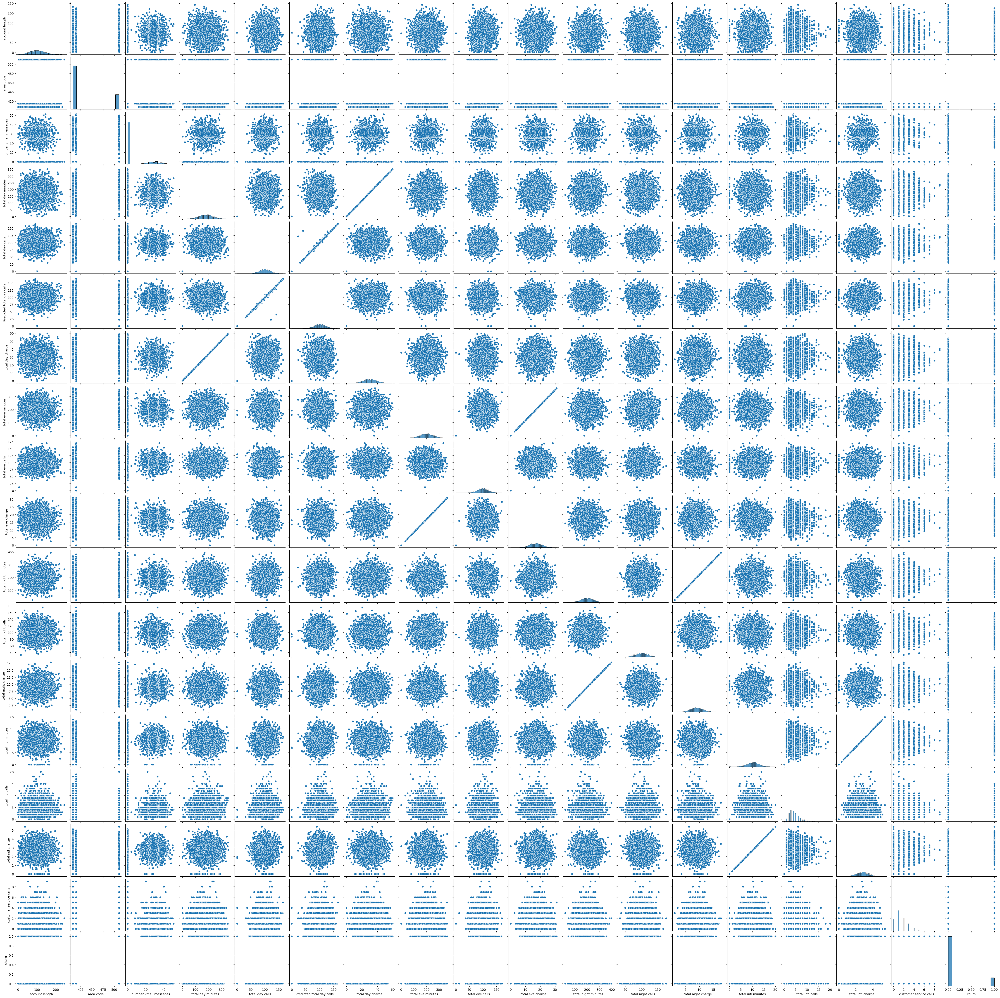

In [38]:
# 10 - Pairwise grid
sns.pairplot(df)

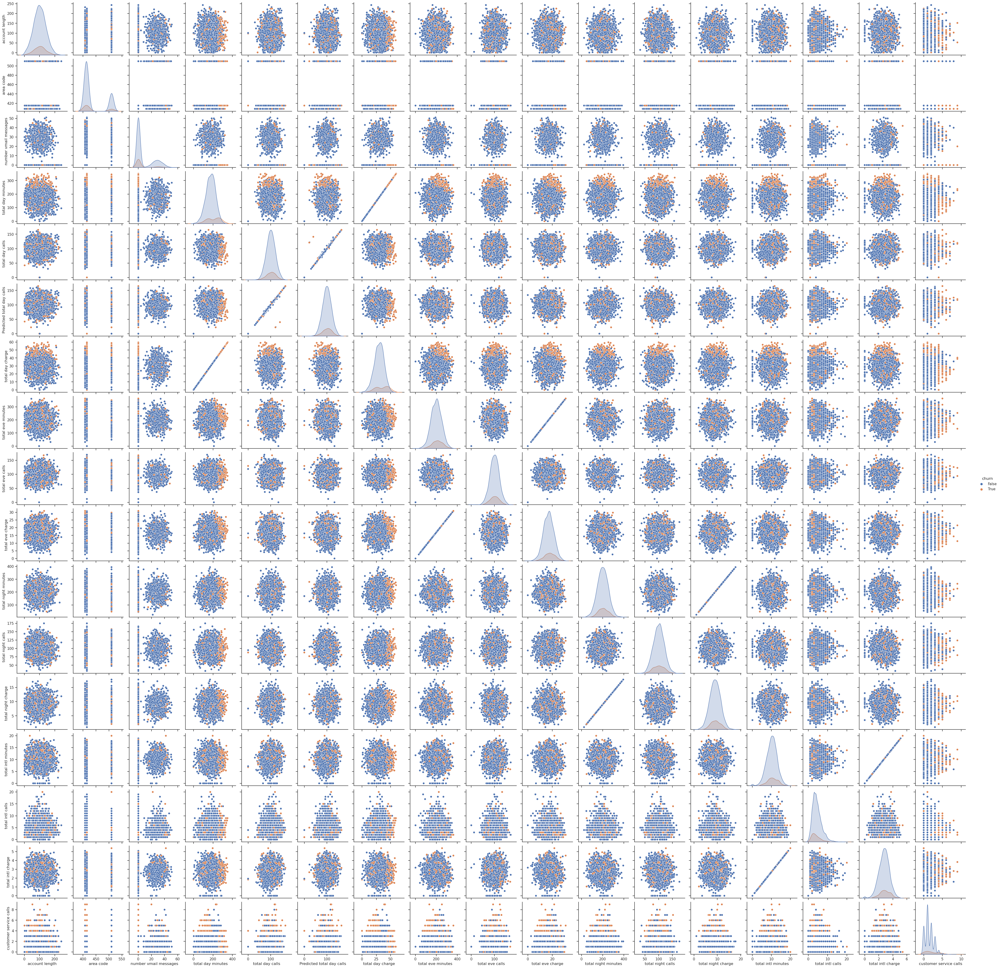

In [45]:
# 11 - Pairwise with Churn
churn = df['churn']
numerical_features = df.select_dtypes(include='number')

# Combine numerical features and churn into a single DataFrame
data = pd.concat([numerical_features, churn], axis=1)

# Create a pairplot with hue="churn"
sns.set(style='ticks')
sns.pairplot(data, hue='churn')
plt.show()

In [49]:
# 12 - Select non-numerical features
non_numerical_features = df.select_dtypes(exclude='number')
print(non_numerical_features)

# Show statistics on non-numerical features
for feature in non_numerical_features.columns:
    value_counts = df[feature].value_counts()
    print("Statistics for", feature)
    print(value_counts)
    print()


     state phone number international plan voice mail plan  churn
0       KS     382-4657                 no             yes  False
1       OH     371-7191                 no             yes  False
2       NJ     358-1921                 no              no  False
3       OH     375-9999                yes              no  False
4       OK     330-6626                yes              no  False
...    ...          ...                ...             ...    ...
3328    AZ     414-4276                 no             yes  False
3329    WV     370-3271                 no              no  False
3330    RI     328-8230                 no              no  False
3331    CT     364-6381                yes              no  False
3332    TN     400-4344                 no             yes  False

[3333 rows x 5 columns]
Statistics for state
WV    106
MN     84
NY     83
AL     80
WI     78
OH     78
OR     78
WY     77
VA     77
CT     74
MI     73
ID     73
VT     73
TX     72
UT     72
IN     71
MD

In [52]:
# 13 - Sorting by total day charge
df.sort_values(by='total day charge', ascending=False)

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,Predicted total day calls,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
365,CO,154,415,343-5709,no,no,0,350.8,75,75,...,94,18.40,253.9,100,11.43,10.1,9,2.73,1,True
985,NY,64,415,345-9140,yes,no,0,346.8,55,55,...,79,21.21,275.4,102,12.39,13.3,9,3.59,1,True
2594,OH,115,510,348-1163,yes,no,0,345.3,81,81,...,106,17.29,217.5,107,9.79,11.8,8,3.19,1,True
156,OH,83,415,370-9116,no,no,0,337.4,120,120,...,116,19.33,153.9,114,6.93,15.8,7,4.27,0,True
605,MO,112,415,373-2053,no,no,0,335.5,77,78,...,109,18.06,265.0,132,11.93,12.7,8,3.43,2,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1986,WI,70,415,405-9233,no,no,0,7.9,100,100,...,83,11.59,156.6,89,7.05,12.1,1,3.27,0,False
2753,OH,134,415,406-4158,no,no,0,7.8,86,86,...,100,14.57,186.5,80,8.39,12.9,2,3.48,2,False
2736,OK,127,510,403-1128,no,yes,27,2.6,113,113,...,102,21.59,242.7,156,10.92,9.2,5,2.48,3,False
1397,VT,101,510,413-7655,no,no,0,0.0,0,0,...,119,16.33,168.8,95,7.60,7.2,4,1.94,1,False


In [53]:
# 14 - Sorting by state and total day charge
df.sort_values(by=['state', 'total day charge'], ascending=False)

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,Predicted total day calls,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
2874,WY,134,510,366-1084,no,no,0,296.0,93,93,...,117,19.24,246.8,98,11.11,12.3,10,3.32,0,True
730,WY,94,510,353-8363,no,no,0,271.2,105,105,...,105,17.22,221.6,51,9.97,11.5,3,3.11,3,True
1136,WY,106,415,338-6018,yes,yes,26,270.3,111,111,...,90,18.29,254.0,133,11.43,14.4,7,3.89,1,True
653,WY,87,415,341-9443,no,yes,22,263.8,65,65,...,115,8.79,208.1,109,9.36,8.5,3,2.30,3,False
1018,WY,76,415,408-6326,no,no,0,263.4,148,148,...,69,19.58,170.6,101,7.68,11.4,5,3.08,1,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
950,AK,108,415,330-5462,no,no,0,103.0,129,129,...,103,20.60,170.2,89,7.66,7.9,3,2.13,1,False
684,AK,110,408,396-2335,no,no,0,100.1,90,93,...,93,19.83,204.4,57,9.20,11.1,8,3.00,3,False
1417,AK,141,408,338-8566,no,no,0,83.2,74,74,...,104,16.20,150.5,79,6.77,10.7,7,2.89,1,False
2269,AK,138,415,340-3409,no,yes,37,75.8,102,102,...,147,14.76,162.6,96,7.32,8.2,13,2.21,0,False


In [58]:
# 15 - Average values for numerical features for churned users
df[df['churn']==True].select_dtypes(include='number').mean()

account length               102.664596
area code                    437.817805
number vmail messages          5.115942
total day minutes            206.914079
total day calls              101.335404
Predicted total day calls    100.971014
total day charge              35.175921
total eve minutes            212.410145
total eve calls              100.561077
total eve charge              18.054969
total night minutes          205.231677
total night calls            100.399586
total night charge             9.235528
total intl minutes            10.700000
total intl calls               4.163561
total intl charge              2.889545
customer service calls         2.229814
dtype: float64

In [62]:
# 16 - Maximum length of calls among users
df[['total day minutes', 'total eve minutes', 'total night minutes', 'total intl minutes']].max()

total day minutes      350.8
total eve minutes      363.7
total night minutes    395.0
total intl minutes      20.0
dtype: float64

In [67]:
#17 - The first 5 rows and the first 3 columns
df.iloc[:5, :3]

,state,account length,area code
0,KS,128,415
1,OH,107,415
2,NJ,137,415
3,OH,84,408
4,OK,75,415


In [71]:
#18 - First and last line separately
print(df.head(1))
print(df.tail(1))

  state  account length  area code phone number international plan  \
0    KS             128        415     382-4657                 no   

  voice mail plan  number vmail messages  total day minutes  total day calls  \
0             yes                     25              265.1              110   

   Predicted total day calls  ...  total eve calls  total eve charge  \
0                        100  ...               99             16.78   

   total night minutes  total night calls  total night charge  \
0                244.7                 91               11.01   

   total intl minutes  total intl calls  total intl charge  \
0                10.0                 3                2.7   

   customer service calls  churn  
0                       1  False  

[1 rows x 22 columns]
     state  account length  area code phone number international plan  \
3332    TN              74        415     400-4344                 no   

     voice mail plan  number vmail messages  total day mi

In [17]:
# 19 - Max value for each column
df.max()

state                              WY
account length                    243
area code                         510
phone number                 422-9964
international plan                yes
voice mail plan                   yes
number vmail messages              51
total day minutes               350.8
total day calls                   165
Predicted total day calls         165
total day charge                59.64
total eve minutes               363.7
total eve calls                   170
total eve charge                30.91
total night minutes             395.0
total night calls                 175
total night charge              17.77
total intl minutes               20.0
total intl calls                   20
total intl charge                 5.4
customer service calls              9
churn                            True
dtype: object

In [94]:
# 20 - All states starting with W, by using lambda
states = df['state']
state_W = lambda x: x[0] == "W"
states[df['state'].apply(state_W)].unique()

array(['WV', 'WY', 'WI', 'WA'], dtype=object)

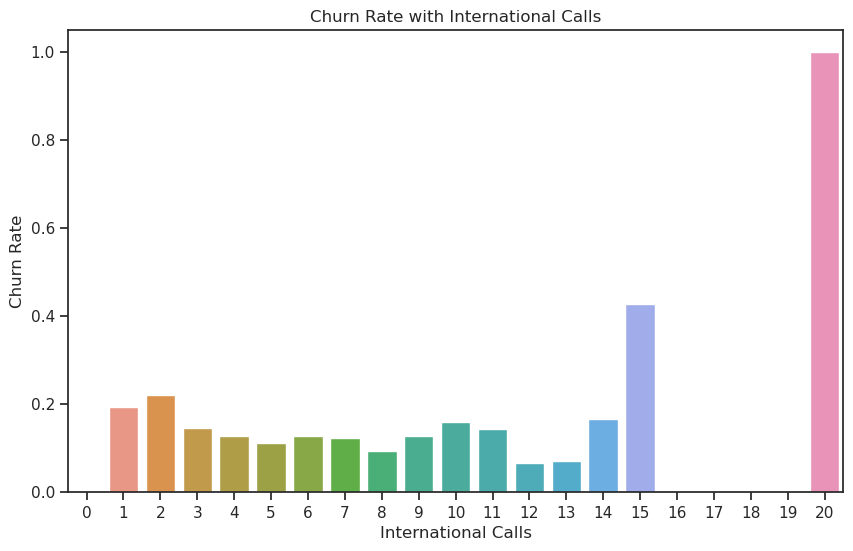

In [98]:
# 21 - Calculate the churn rate with international calls
churn_rate = df.groupby('total intl calls')['churn'].mean().reset_index()

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='total intl calls', y='churn', data=churn_rate)
plt.xlabel('International Calls')
plt.ylabel('Churn Rate')
plt.title('Churn Rate with International Calls')
plt.show()


   Customer Service Calls  Count
0                       0    697
1                       1   1181
2                       2    759
3                       3    429
4                       4    166
5                       5     66
6                       6     22
7                       7      9
8                       8      2
9                       9      2


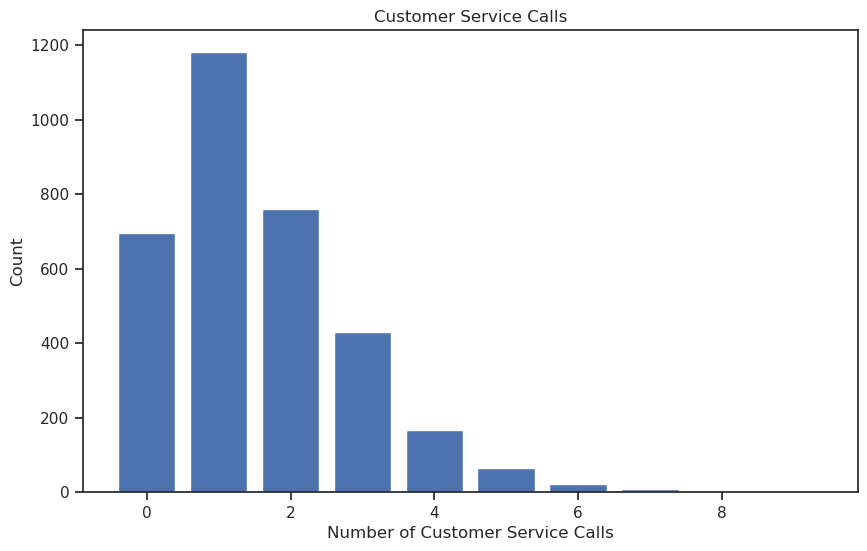

In [100]:
# 22 - Customer Service Calls and Summary table
# Extract the 'customer service calls' column
customer_service_calls = df['customer service calls']

# Count the occurrences of each value
call_counts = customer_service_calls.value_counts().sort_index()

# Create a summary table
summary_table = pd.DataFrame({'Customer Service Calls': call_counts.index, 'Count': call_counts.values})

# Display the summary table
print(summary_table)

# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(call_counts.index, call_counts.values)
plt.xlabel('Number of Customer Service Calls')
plt.ylabel('Count')
plt.title('Customer Service Calls')
plt.show()


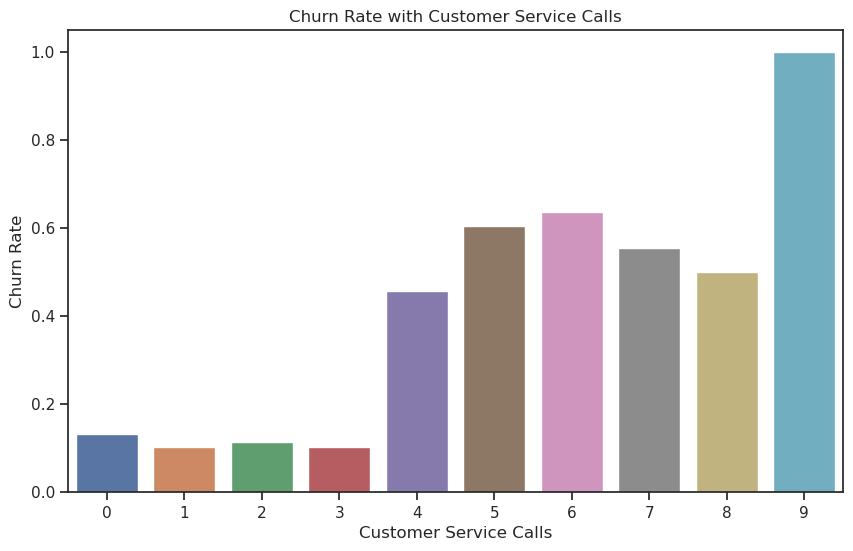

In [103]:
# 23 - Calculate the churn rate with customer service calls
churn_rate = df.groupby('customer service calls')['churn'].mean().reset_index()

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='customer service calls', y='churn', data=churn_rate)
plt.xlabel('Customer Service Calls')
plt.ylabel('Churn Rate')
plt.title('Churn Rate with Customer Service Calls')
plt.show()


In [105]:
# 24 - Correlation between churn and all other numerical values
churn = df['churn']
# Calculate the correlation
correlation = numerical_features.corrwith(churn)

# Display the correlation
print(correlation)


account length               0.016541
area code                    0.006174
number vmail messages       -0.089728
total day minutes            0.205151
total day calls              0.018459
Predicted total day calls    0.012189
total day charge             0.205151
total eve minutes            0.092796
total eve calls              0.009233
total eve charge             0.092786
total night minutes          0.035493
total night calls            0.006141
total night charge           0.035496
total intl minutes           0.068239
total intl calls            -0.052844
total intl charge            0.068259
customer service calls       0.208750
dtype: float64


In [120]:
# 25 - Proportion of churned users in the dataset
churn_counts = df['churn'].value_counts()

churned = (churn_counts[True] / df.shape[0])*100
print(f"The perecentage of churned users in the dataset is {churned:.2f}%")

The perecentage of churned users in the dataset is 14.49%


In [126]:
# 26 - Mean Square Error
diff = np.subtract(df['total day calls'], df['Predicted total day calls'])
sq_diff = np.square(diff)
sq_diff.mean()

9.370237023702371